# Data Analysis

This notebook contains the analysis performed on the dataset, including visualizations and insights derived from the exploratory data analysis (EDA).

In [375]:
import pandas as pd 
import numpy as np 
import requests
import os
import time
from dotenv import load_dotenv
from sqlalchemy import create_engine
import glob
import matplotlib.pyplot as plt
from matplotlib import pyplot as plt 
from matplotlib.widgets import CheckButtons 
from sklearn.preprocessing import StandardScaler
from matplotlib.collections import LineCollection

In [376]:
data = pd.read_csv('/Users/blairjdaniel/fintech_fraud/data/btc_hist.csv')
data_all = pd.read_csv("/Users/blairjdaniel/fintech_fraud/data/bitcoin_hist.csv")
df = pd.read_csv('/Users/blairjdaniel/fintech_fraud/data/finding/metrics.csv')
clean_fed = pd.read_csv('/Users/blairjdaniel/fintech_fraud/data/clean_fed.csv')
bitcoin_data = pd.read_csv('/Users/blairjdaniel/fintech_fraud/data/sql_files/bitcoin_data.csv')
events = pd.read_csv('/Users/blairjdaniel/fintech_fraud/data/events_updated.csv')
scaled_df = pd.read_csv('/Users/blairjdaniel/fintech_fraud/data/finals/scaled_df.csv')



In [377]:
scaled_df = scaled_df.rename(columns={'price': 'btc_price'})
scaled_df = scaled_df.drop(columns=['Unnamed: 0'])

In [378]:
events_halving = events[events['subcategory'] == 'bitcoin_halving']
events_election = events[events['subcategory'] == 'presidential_election']
events_crypto = events[events['category'] == 'crypto']
events_economic = events[events['category'] == 'economic']
events_shock = events[events['category'] == 'shock']

/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/3021762270.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  events_halving['date'] = pd.to_datetime(events_halving['date'])


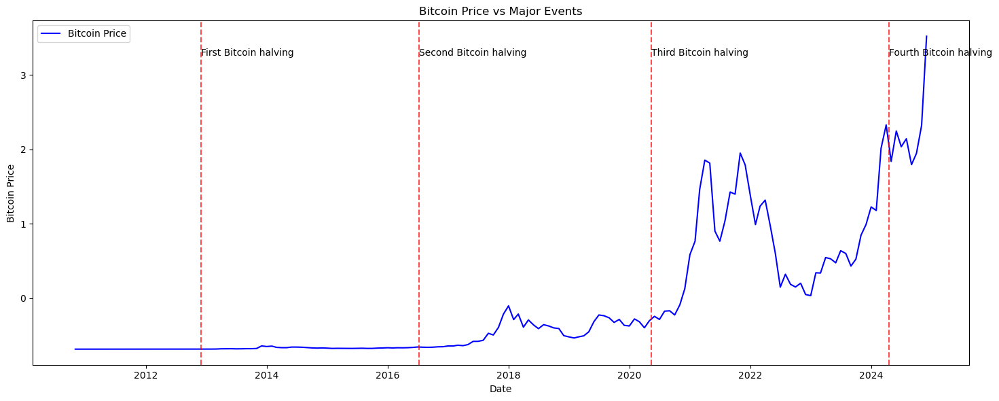

In [379]:
# Convert the events_halving date column to datetime (if necessary)
events_halving['date'] = pd.to_datetime(events_halving['date'])

# (Optional) sort events_halving DataFrame by date
events_halving = events_halving.sort_values('date')

# Ensure the 'date' column in scaled_df is in datetime format
scaled_df['date'] = pd.to_datetime(scaled_df['date'])

# Example: Plot bitcoin price over time
fig, ax = plt.subplots(figsize=(15, 6))
ax.plot(scaled_df['date'], scaled_df['btc_price'], label='Bitcoin Price', color='blue')

# Loop over events_halving and add vertical markers
for idx, row in events_halving.iterrows():
	# Add a vertical line at the event date
	ax.axvline(x=row['date'], color='red', linestyle='--', alpha=0.7)
	# Add text to label the event – adjust vertical placement as needed
	ax.text(row['date'], ax.get_ylim()[1] * 0.9, row['description'], 
			rotation=0, verticalalignment='top', fontsize=10, color='black')

ax.set_title('Bitcoin Price vs Major Events')
ax.set_xlabel('Date')
ax.set_ylabel('Bitcoin Price')
ax.legend()
plt.tight_layout()
plt.show()

/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/492459458.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  events_election['date'] = pd.to_datetime(events_election['date'])


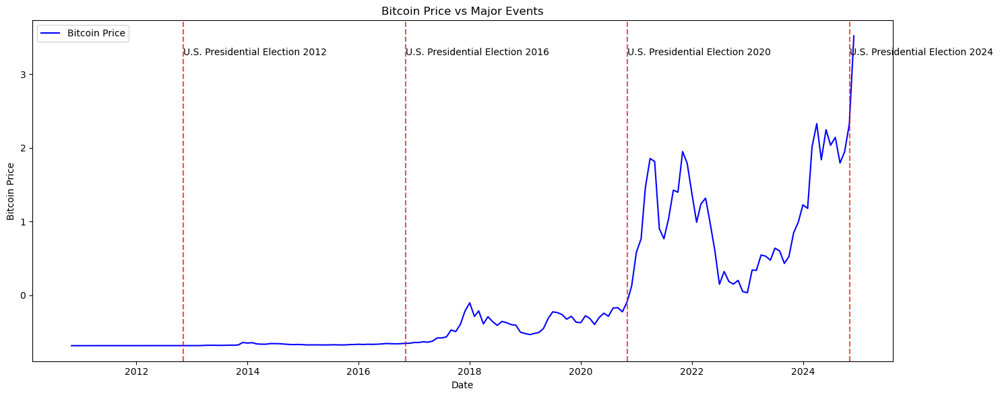

In [380]:
# Convert the events_election date column to datetime (if necessary)
events_election['date'] = pd.to_datetime(events_election['date'])

# (Optional) sort events_election DataFrame by date
events_election = events_election.sort_values('date')

# Ensure the 'date' column in scaled_df is in datetime format
scaled_df['date'] = pd.to_datetime(scaled_df['date'])

# Example: Plot bitcoin price over time
fig, ax = plt.subplots(figsize=(15, 6))
ax.plot(scaled_df['date'], scaled_df['btc_price'], label='Bitcoin Price', color='blue')

# Loop over events_election and add vertical markers
for idx, row in events_election.iterrows():
	# Add a vertical line at the event date
	ax.axvline(x=row['date'], color='red', linestyle='--', alpha=0.7)
	# Add text to label the event – adjust vertical placement as needed
	ax.text(row['date'], ax.get_ylim()[1] * 0.9, row['description'], 
			rotation=0, verticalalignment='top', fontsize=10, color='black')

ax.set_title('Bitcoin Price vs Major Events')
ax.set_xlabel('Date')
ax.set_ylabel('Bitcoin Price')
ax.legend()
plt.tight_layout()
plt.show()

/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/2689613214.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  events_crypto['date'] = pd.to_datetime(events_crypto['date'])


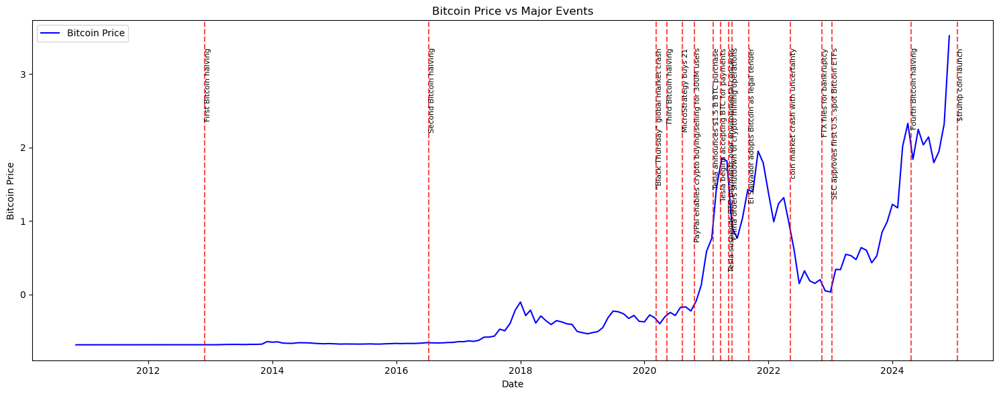

In [381]:
# Convert the events_crypto date column to datetime (if necessary)
events_crypto['date'] = pd.to_datetime(events_crypto['date'])

# (Optional) sort events_crypto DataFrame by date
events_crypto = events_crypto.sort_values('date')

# Ensure the 'date' column in scaled_df is in datetime format
scaled_df['date'] = pd.to_datetime(scaled_df['date'])

# Example: Plot bitcoin price over time
fig, ax = plt.subplots(figsize=(15, 6))
ax.plot(scaled_df['date'], scaled_df['btc_price'], label='Bitcoin Price', color='blue')

# Loop over events_crypto and add vertical markers
for idx, row in events_crypto.iterrows():
	# Add a vertical line at the event date
	ax.axvline(x=row['date'], color='red', linestyle='--', alpha=0.7)
	# Add text to label the event – adjust vertical placement as needed
	ax.text(row['date'], ax.get_ylim()[1] * 0.9, row['description'], 
			rotation=90, verticalalignment='top', fontsize=8, color='black')

ax.set_title('Bitcoin Price vs Major Events')
ax.set_xlabel('Date')
ax.set_ylabel('Bitcoin Price')
ax.legend()
plt.tight_layout()
plt.show()

/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/487667630.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  events_economic['date'] = pd.to_datetime(events_economic['date'])


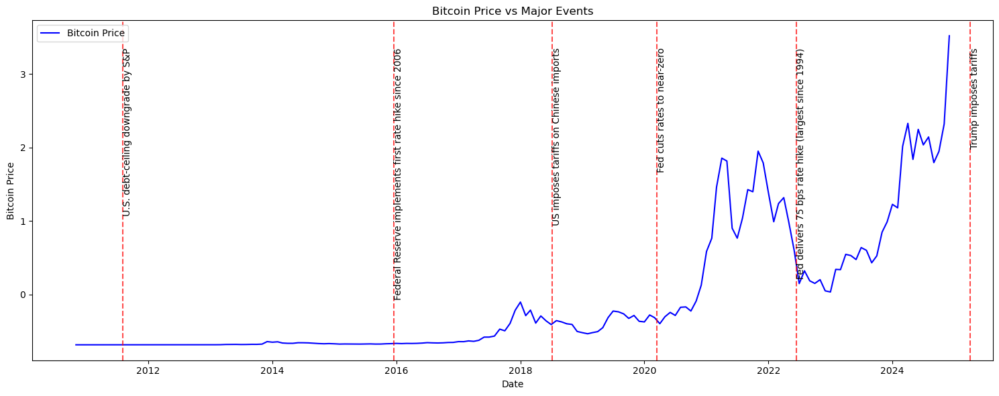

In [382]:
# Convert the events_economic date column to datetime (if necessary)
events_economic['date'] = pd.to_datetime(events_economic['date'])

# (Optional) sort events_economic DataFrame by date
events_economic = events_economic.sort_values('date')

# Ensure the 'date' column in scaled_df is in datetime format
scaled_df['date'] = pd.to_datetime(scaled_df['date'])

# Example: Plot bitcoin price over time
fig, ax = plt.subplots(figsize=(15, 6))
ax.plot(scaled_df['date'], scaled_df['btc_price'], label='Bitcoin Price', color='blue')

# Loop over events_economic and add vertical markers
for idx, row in events_economic.iterrows():
	# Add a vertical line at the event date
	ax.axvline(x=row['date'], color='red', linestyle='--', alpha=0.7)
	# Add text to label the event – adjust vertical placement as needed
	ax.text(row['date'], ax.get_ylim()[1] * 0.9, row['description'], 
			rotation=90, verticalalignment='top', fontsize=10, color='black')

ax.set_title('Bitcoin Price vs Major Events')
ax.set_xlabel('Date')
ax.set_ylabel('Bitcoin Price')
ax.legend()
plt.tight_layout()
plt.show()

/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/4192904474.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  events_shock['date'] = pd.to_datetime(events_shock['date'])


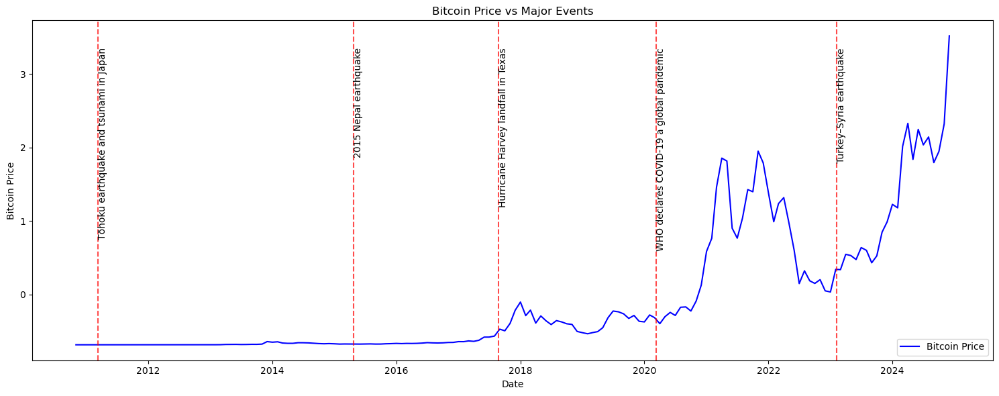

In [383]:
# Convert the events_shock date column to datetime (if necessary)
events_shock['date'] = pd.to_datetime(events_shock['date'])

# (Optional) sort events_shock DataFrame by date
events_shock = events_shock.sort_values('date')

# Ensure the 'date' column in scaled_df is in datetime format
scaled_df['date'] = pd.to_datetime(scaled_df['date'])

# Example: Plot bitcoin price over time
fig, ax = plt.subplots(figsize=(15, 6))
ax.plot(scaled_df['date'], scaled_df['btc_price'], label='Bitcoin Price', color='blue')

# Loop over events_shock and add vertical markers
for idx, row in events_shock.iterrows():
	# Add a vertical line at the event date
	ax.axvline(x=row['date'], color='red', linestyle='--', alpha=0.7)
	# Add text to label the event – adjust vertical placement as needed
	ax.text(row['date'], ax.get_ylim()[1] * 0.9, row['description'], 
			rotation=90, verticalalignment='top', fontsize=10, color='black')

ax.set_title('Bitcoin Price vs Major Events')
ax.set_xlabel('Date')
ax.set_ylabel('Bitcoin Price')
ax.legend()
plt.tight_layout()
plt.show()

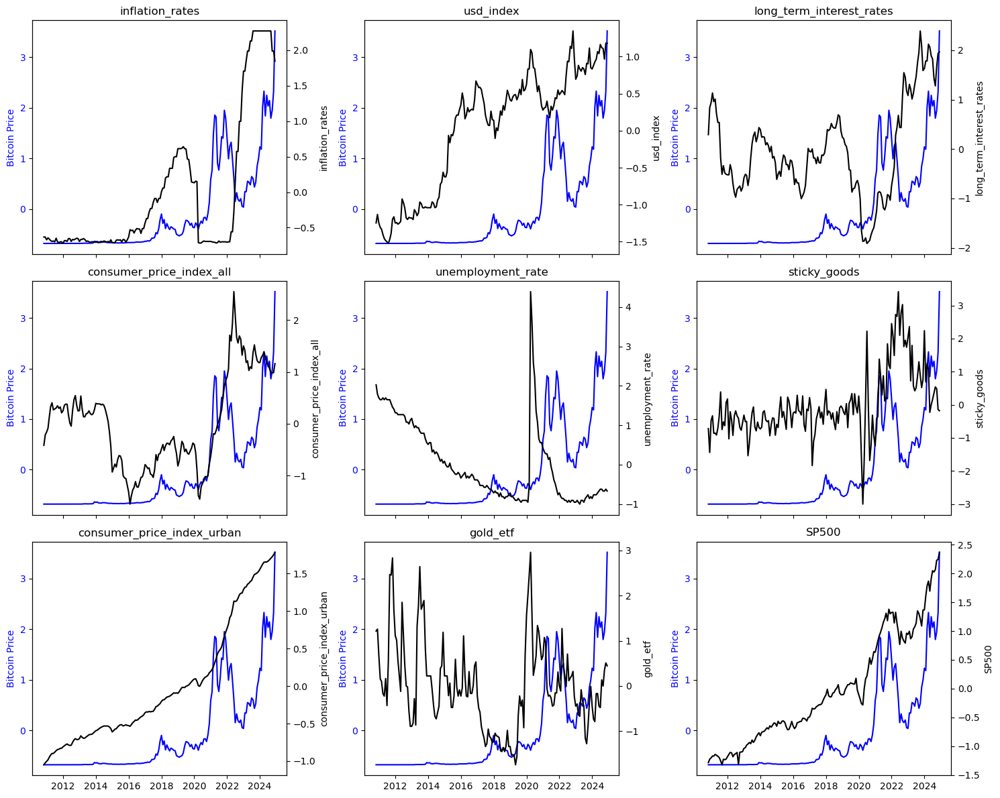

In [384]:
import math

# Example for scaled_df
# Ensure the date columns are in datetime format
#bitcoin_data['date'] = pd.to_datetime(bitcoin_data['date'])
scaled_df['date'] = pd.to_datetime(scaled_df['date'])


# Get the fed columns (all columns except date and btc_price)
fed_cols = scaled_df.columns.drop(['date', 'btc_price'])

num_plots = len(fed_cols)
cols_per_row = 3
rows = math.ceil(num_plots / cols_per_row)

fig, axes = plt.subplots(rows, cols_per_row, figsize=(5 * cols_per_row, 4 * rows), sharex=True)
axes = axes.flatten()

for i, col in enumerate(fed_cols):
	ax1 = axes[i]
	ax2 = ax1.twinx()
	# Plot bitcoin btc_price on the left y-axis
	ax1.plot(scaled_df['date'], scaled_df['btc_price'], color='blue', label='Bitcoin Price')
	# Plot the fed variable on the right y-axis
	ax2.plot(scaled_df['date'], scaled_df[col], color='black', label=col)
	ax1.set_title(col)
	ax1.set_ylabel('Bitcoin Price', color='blue')
	ax2.set_ylabel(col, color='black')
	ax1.tick_params(axis='y', labelcolor='blue')
	ax2.tick_params(axis='y', labelcolor='black')

# Remove any unused axes if num_plots < total subplots
for j in range(i + 1, len(axes)):
	fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [385]:
bitcoin_data.head()

,date,price,open,high,low,volume,change_percent,parkinson_volatility
0,2025-04-30,94627.6,94265.0,95223.4,93049.6,61650.0,0.38,0.013869
1,2025-04-29,94269.8,94995.4,95453.4,93758.0,59860.0,-0.76,0.010763
2,2025-04-28,94995.0,93742.5,95580.3,92818.9,73630.0,1.34,0.017606
3,2025-04-27,93742.5,94631.4,95324.4,93640.7,36660.0,-0.94,0.010702
4,2025-04-26,94631.4,94669.3,95207.0,93891.8,33770.0,-0.05,0.008354


In [386]:
# Calculate the percentage gained after each halving
bitcoin_data['price_change_perc'] = bitcoin_data['price'].pct_change() * 100

# Calculate the percentage change in the 'Price Change (%)' column
bitcoin_data['price_change_delta_perc'] = bitcoin_data['price_change_perc'].pct_change() * 100

bitcoin_data =  bitcoin_data.drop(columns=['open', 'high', 'low', 'change_percent'])


In [387]:
bitcoin_data.head()

,date,price,volume,parkinson_volatility,price_change_perc,price_change_delta_perc
0,2025-04-30,94627.6,61650.0,0.013869,NaN,NaN
1,2025-04-29,94269.8,59860.0,0.010763,-0.378114,NaN
2,2025-04-28,94995.0,73630.0,0.017606,0.769281,-303.452345
3,2025-04-27,93742.5,36660.0,0.010702,-1.318490,-271.392486
4,2025-04-26,94631.4,33770.0,0.008354,0.948236,-171.918296


In [388]:

# Define the Bitcoin halving data
halving_data = {
    "halving_number": [
        0, 1, 2, 3, 
        4, 5, 6, 7, 8
    ],
    "date": [
        "2009-01-03", "2012-11-28", "2016-07-09", "2020-05-11", 
        "2024-04-19", "2028-06-30", "2032-06-30", "2036-06-30", "2040-06-30"
    ],
    "block_number": [
        0, 210000, 420000, 630000, 840000, 1050000, 1260000, 1470000, 1680000
    ],
    "block_reward": [
        50, 25, 12.5, 6.25, 3.125, 1.5625, 0.78125, 0.390625, 0.1953125
    ],
    "btc_mined": [
        "50%", "75%", "87.5%", "93.75%", "96.875%", "98.4375%", "99.21875%", "99.609375%", "99.8046875%"
    ],
    "Price on Halving Day (USD)": [
        0.20, 12.35, 650.53, 8571.67, 63842.56, None, None, None, None
    ]
}

# Create a DataFrame
halving_df = pd.DataFrame(halving_data)

# Convert the 'date' column to datetime format
halving_df['date'] = pd.to_datetime(halving_df['date'], errors='coerce')

# Calculate the percentage gained after each halving
halving_df['Price Change (%)'] = halving_df['Price on Halving Day (USD)'].pct_change() * 100

# Adjust the price change by the block reward to simulate cooling off
# Adjust the price change by the block reward to simulate cooling off
halving_df['Adjusted Price Change (%)'] = halving_df['Price Change (%)'] / halving_df['block_reward']

# Calculate volatility as inversely proportional to the block reward
halving_df['Volatility'] = 1 / halving_df['block_reward']
# Calculate volatility as inversely proportional to the block reward
halving_df['Volatility'] = 1 / halving_df['block_reward']

# Ensure the 'Price Change (%)' and 'block_reward' columns are numeric
halving_df['Price Change (%)'] = pd.to_numeric(halving_df['Price Change (%)'], errors='coerce')
halving_df['block_reward'] = pd.to_numeric(halving_df['block_reward'], errors='coerce')

# Calculate the percentage change in the 'Price Change (%)' column
halving_df['Price Change Delta (%)'] = halving_df['Price Change (%)'].pct_change() * 100

# Calculate the percentage change in the 'Block Reward (btc_minedn
halving_df['block_reward_change'] = halving_df['block_reward'].pct_change() * 100

# Ensure 'btc_mined' is numeric (convert percentage strings to float)
if halving_df['btc_mined'].dtype == 'object':
    halving_df['btc_mined'] = halving_df['btc_mined'].str.rstrip('%').astype(float) / 100

# Calculate the percentage change in 'btc_mined'
halving_df['btc_mined_change'] = halving_df["btc_mined"].pct_change() * 100
# Display the DataFrame
halving_df

/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/1657688246.py:32: FutureWarning: The default fill_method='pad' in Series.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  halving_df['Price Change (%)'] = halving_df['Price on Halving Day (USD)'].pct_change() * 100


,halving_number,date,block_number,block_reward,btc_mined,Price on Halving Day (USD),Price Change (%),Adjusted Price Change (%),Volatility,Price Change Delta (%),block_reward_change,btc_mined_change
0,0,2009-01-03,0,50.000000,0.500000,0.20,NaN,NaN,0.02,NaN,NaN,NaN
1,1,2012-11-28,210000,25.000000,0.750000,12.35,6075.000000,243.000000,0.04,NaN,-50.0,50.000000
2,2,2016-07-09,420000,12.500000,0.875000,650.53,5167.449393,413.395951,0.08,-14.939105,-50.0,16.666667
3,3,2020-05-11,630000,6.250000,0.937500,8571.67,1217.644075,194.823052,0.16,-76.436265,-50.0,7.142857
4,4,2024-04-19,840000,3.125000,0.968750,63842.56,644.808888,206.338844,0.32,-47.044551,-50.0,3.333333
5,5,2028-06-30,1050000,1.562500,0.984375,NaN,0.000000,0.000000,0.64,-100.000000,-50.0,1.612903
6,6,2032-06-30,1260000,0.781250,0.992188,NaN,0.000000,0.000000,1.28,NaN,-50.0,0.793651
7,7,2036-06-30,1470000,0.390625,0.996094,NaN,0.000000,0.000000,2.56,NaN,-50.0,0.393701
8,8,2040-06-30,1680000,0.195312,0.998047,NaN,0.000000,0.000000,5.12,NaN,-50.0,0.196078


In [389]:
# Ensure the 'date' columns in both DataFrames are in datetime format
halving_df['date'] = pd.to_datetime(halving_df['date'], errors='coerce')
bitcoin_data['date'] = pd.to_datetime(bitcoin_data['date'], errors='coerce')

# Merge the DataFrames using a left join
bitcoin_df = pd.merge_asof(
    bitcoin_data.sort_values('date'),  # Sort bitcoin_data by date
    halving_df.sort_values('date'),   # Sort halving_df by date
    on='date',                        # Merge on the 'date' column
    direction='backward'              # Propagate the most recent halving data backward
)

# Display the merged DataFrame
bitcoin_df

,date,price,volume,parkinson_volatility,price_change_perc,price_change_delta_perc,halving_number,block_number,block_reward,btc_mined,Price on Halving Day (USD),Price Change (%),Adjusted Price Change (%),Volatility,Price Change Delta (%),block_reward_change,btc_mined_change
0,2010-11-01,0.2,21260.0,0.000000,0.000000,NaN,0,0,50.000,0.50000,0.20,NaN,NaN,0.02,NaN,NaN,NaN
1,2010-11-02,0.2,5850.0,0.000000,0.000000,NaN,0,0,50.000,0.50000,0.20,NaN,NaN,0.02,NaN,NaN,NaN
2,2010-11-03,0.2,61470.0,0.659784,0.000000,-100.000000,0,0,50.000,0.50000,0.20,NaN,NaN,0.02,NaN,NaN,NaN
3,2010-11-04,0.2,29700.0,0.000000,-33.333333,33.333333,0,0,50.000,0.50000,0.20,NaN,NaN,0.02,NaN,NaN,NaN
4,2010-11-05,0.3,36620.0,0.243507,-25.000000,-175.000000,0,0,50.000,0.50000,0.20,NaN,NaN,0.02,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5290,2025-04-26,94631.4,33770.0,0.008354,0.948236,-171.918296,4,840000,3.125,0.96875,63842.56,644.808888,206.338844,0.32,-47.044551,-50.0,3.333333
5291,2025-04-27,93742.5,36660.0,0.010702,-1.318490,-271.392486,4,840000,3.125,0.96875,63842.56,644.808888,206.338844,0.32,-47.044551,-50.0,3.333333
5292,2025-04-28,94995.0,73630.0,0.017606,0.769281,-303.452345,4,840000,3.125,0.96875,63842.56,644.808888,206.338844,0.32,-47.044551,-50.0,3.333333
5293,2025-04-29,94269.8,59860.0,0.010763,-0.378114,NaN,4,840000,3.125,0.96875,63842.56,644.808888,206.338844,0.32,-47.044551,-50.0,3.333333


In [390]:
# Fill NaN values in 'block_reward_change' and 'btc_mined_change' columns with 0
bitcoin_df['block_reward_change'] = bitcoin_df['block_reward_change'].fillna(0)
bitcoin_df['btc_mined_change'] = bitcoin_df['btc_mined_change'].fillna(0)

In [391]:
from sklearn.impute import KNNImputer

# Select the columns to impute (numeric columns only)
numeric_columns = bitcoin_df.select_dtypes(include=['float64', 'int64']).columns

# Replace infinite values with NaN
bitcoin_df[numeric_columns] = bitcoin_df[numeric_columns].replace([np.inf, -np.inf], np.nan)

# Initialize the KNN Imputer
knn_imputer = KNNImputer(n_neighbors=5)  # You can adjust n_neighbors as needed

# Apply the KNN Imputer to the numeric columns
bitcoin_df[numeric_columns] = knn_imputer.fit_transform(bitcoin_df[numeric_columns])

# Display the updated DataFrame
bitcoin_df

,date,price,volume,parkinson_volatility,price_change_perc,price_change_delta_perc,halving_number,block_number,block_reward,btc_mined,Price on Halving Day (USD),Price Change (%),Adjusted Price Change (%),Volatility,Price Change Delta (%),block_reward_change,btc_mined_change
0,2010-11-01,0.2,21260.0,0.000000,0.000000,-157.738437,0.0,0.0,50.000,0.50000,0.20,6075.000000,243.000000,0.02,-14.939105,0.0,0.000000
1,2010-11-02,0.2,5850.0,0.000000,0.000000,-138.861375,0.0,0.0,50.000,0.50000,0.20,6075.000000,243.000000,0.02,-14.939105,0.0,0.000000
2,2010-11-03,0.2,61470.0,0.659784,0.000000,-100.000000,0.0,0.0,50.000,0.50000,0.20,6075.000000,243.000000,0.02,-14.939105,0.0,0.000000
3,2010-11-04,0.2,29700.0,0.000000,-33.333333,33.333333,0.0,0.0,50.000,0.50000,0.20,6075.000000,243.000000,0.02,-14.939105,0.0,0.000000
4,2010-11-05,0.3,36620.0,0.243507,-25.000000,-175.000000,0.0,0.0,50.000,0.50000,0.20,6075.000000,243.000000,0.02,-14.939105,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5290,2025-04-26,94631.4,33770.0,0.008354,0.948236,-171.918296,4.0,840000.0,3.125,0.96875,63842.56,644.808888,206.338844,0.32,-47.044551,-50.0,3.333333
5291,2025-04-27,93742.5,36660.0,0.010702,-1.318490,-271.392486,4.0,840000.0,3.125,0.96875,63842.56,644.808888,206.338844,0.32,-47.044551,-50.0,3.333333
5292,2025-04-28,94995.0,73630.0,0.017606,0.769281,-303.452345,4.0,840000.0,3.125,0.96875,63842.56,644.808888,206.338844,0.32,-47.044551,-50.0,3.333333
5293,2025-04-29,94269.8,59860.0,0.010763,-0.378114,-218.775291,4.0,840000.0,3.125,0.96875,63842.56,644.808888,206.338844,0.32,-47.044551,-50.0,3.333333


In [392]:
bitcoin_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5295 entries, 0 to 5294
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   date                        5295 non-null   datetime64[ns]
 1   price                       5295 non-null   float64       
 2   volume                      5295 non-null   float64       
 3   parkinson_volatility        5295 non-null   float64       
 4   price_change_perc           5295 non-null   float64       
 5   price_change_delta_perc     5295 non-null   float64       
 6   halving_number              5295 non-null   float64       
 7   block_number                5295 non-null   float64       
 8   block_reward                5295 non-null   float64       
 9   btc_mined                   5295 non-null   float64       
 10  Price on Halving Day (USD)  5295 non-null   float64       
 11  Price Change (%)            5295 non-null   float64     

In [393]:
bitcoin_df.describe()

,date,price,volume,parkinson_volatility,price_change_perc,price_change_delta_perc,halving_number,block_number,block_reward,btc_mined,Price on Halving Day (USD),Price Change (%),Adjusted Price Change (%),Volatility,Price Change Delta (%),block_reward_change,btc_mined_change
count,5295,5295.000000,5.295000e+03,5295.000000,5295.000000,5.295000e+03,5295.000000,5295.000000,5295.000000,5295.000000,5295.000000,5295.000000,5295.000000,5295.000000,5295.000000,5295.000000,5295.000000
mean,2018-01-30 00:00:00,16017.165156,1.167723e+07,0.036860,-0.076017,-4.146491e+02,1.878754,394538.243626,18.616029,0.813840,7050.380087,4128.011676,272.414021,0.100276,-33.937814,-42.842304,19.046630
min,2010-11-01 00:00:00,0.200000,1.700000e+02,0.000000,-77.103355,-1.320997e+06,0.000000,0.000000,3.125000,0.500000,0.200000,644.808888,194.823052,0.020000,-76.436265,-50.000000,0.000000
25%,2014-06-16 12:00:00,263.100000,3.535500e+04,0.014615,-1.821428,-2.132948e+02,1.000000,210000.000000,6.250000,0.750000,12.350000,1217.644075,194.823052,0.040000,-76.436265,-50.000000,7.142857
50%,2018-01-30 00:00:00,4364.400000,7.174000e+04,0.024516,0.000000,-1.083898e+02,2.000000,420000.000000,12.500000,0.875000,650.530000,5167.449393,243.000000,0.080000,-14.939105,-50.000000,16.666667
75%,2021-09-14 12:00:00,24150.500000,1.733450e+05,0.041126,1.300695,-2.966177e+01,3.000000,630000.000000,25.000000,0.937500,8571.670000,6075.000000,413.395951,0.160000,-14.939105,-50.000000,16.666667
max,2025-04-30 00:00:00,106157.200000,4.470000e+09,0.660818,133.690795,7.334847e+04,4.000000,840000.000000,50.000000,0.968750,63842.560000,6075.000000,413.395951,0.320000,-14.939105,0.000000,50.000000
std,NaN,23553.692919,1.505236e+08,0.045483,5.927269,1.831309e+04,1.167835,245245.321003,14.823691,0.148237,16143.732020,2222.548316,86.893516,0.079652,27.209732,17.513141,18.661596


In [394]:
# Ensure the 'date' column is in datetime format
bitcoin_df['date'] = pd.to_datetime(bitcoin_df['date'], errors='coerce')

# Create a new column for weighted price change
bitcoin_df['weighted_price_change'] = 0.0

# Iterate through each row in bitcoin_df
for idx, row in bitcoin_df.iterrows():
    halving_date = row['date']
    
    # Define the one-year window before and after the halving
    start_date = halving_date - pd.Timedelta(days=365)
    end_date = halving_date + pd.Timedelta(days=365)
    
    # Filter rows within the one-year window
    window_data = bitcoin_df[(bitcoin_df['date'] >= start_date) & (bitcoin_df['date'] <= end_date)]
    
    # Calculate weights (inverse distance from the halving date)
    window_data['weight'] = 1 / (1 + abs((window_data['date'] - halving_date).dt.days))
    
    # Calculate the weighted price change
    weighted_change = (window_data['price_change_perc'] * window_data['weight']).sum() / window_data['weight'].sum()
    
    # Assign the weighted change to the current row
    bitcoin_df.at[idx, 'weighted_price_change'] = weighted_change


/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/1791489149.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  window_data['weight'] = 1 / (1 + abs((window_data['date'] - halving_date).dt.days))
/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/1791489149.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  window_data['weight'] = 1 / (1 + abs((window_data['date'] - halving_date).dt.days))
/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/1791489149.py:19: Set

In [395]:
bitcoin_df.to_csv('/Users/blairjdaniel/fintech_fraud/data/finding/btc_test.csv')

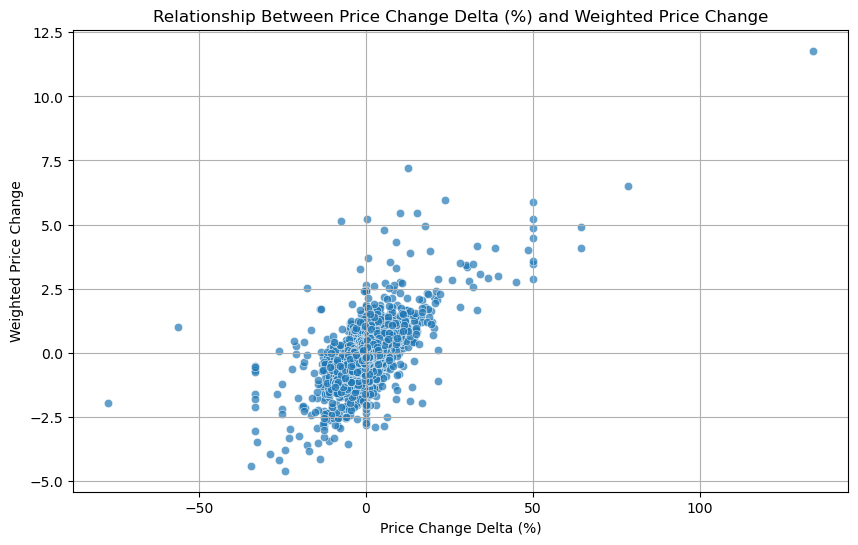

In [396]:
import matplotlib.pyplot as plt
import seaborn as sns

# Scatter plot to visualize the relationship
plt.figure(figsize=(10, 6))
sns.scatterplot(data=bitcoin_df, x='price_change_perc', y='weighted_price_change', alpha=0.7)
plt.title('Relationship Between Price Change Delta (%) and Weighted Price Change')
plt.xlabel('Price Change Delta (%)')
plt.ylabel('Weighted Price Change')
plt.grid(True)
plt.show()


In [397]:
# Ensure the 'date' column is in datetime format
bitcoin_df['date'] = pd.to_datetime(bitcoin_df['date'], errors='coerce')

# Sort the DataFrame by date to ensure proper ordering
bitcoin_df = bitcoin_df.sort_values('date')

# Identify the most recent halving with a valid price_change_delta_perc
last_valid_index = bitcoin_df['price_change_delta_perc'].last_valid_index()
last_valid_value = bitcoin_df.loc[last_valid_index, 'price_change_delta_perc']

# Project future halvings by halving the price_change_delta_perc
for idx in range(last_valid_index + 1, len(bitcoin_df)):
    last_valid_value /= 2  # Halve the previous value
    bitcoin_df.loc[idx, 'price_change_delta_perc'] = last_valid_value

# Display the updated DataFrame
bitcoin_df[['date', 'halving_number', 'price_change_delta_perc']]

,date,halving_number,price_change_delta_perc
0,2010-11-01,0.0,-157.738437
1,2010-11-02,0.0,-138.861375
2,2010-11-03,0.0,-100.000000
3,2010-11-04,0.0,33.333333
4,2010-11-05,0.0,-175.000000
...,...,...,...
5290,2025-04-26,4.0,-171.918296
5291,2025-04-27,4.0,-271.392486
5292,2025-04-28,4.0,-303.452345
5293,2025-04-29,4.0,-218.775291


Mean Squared Error (MSE): 35.10
R² Score: 0.00


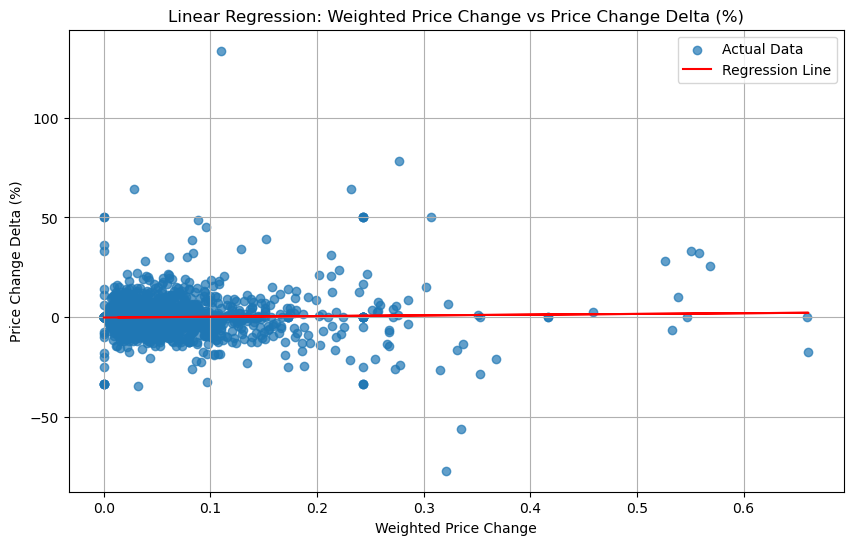

In [398]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
import numpy as np
import matplotlib.pyplot as plt

# Prepare the data
# Drop rows with missing values in the relevant columns
regression_data = bitcoin_df[['weighted_price_change', 'parkinson_volatility', 'price_change_perc']].dropna()

# Define the features (X) and target (y)
X = regression_data[['parkinson_volatility']].values  # Feature
y = regression_data['price_change_perc'].values  # Target

# Initialize and train the linear regression model
model = LinearRegression()
model.fit(X, y)

# Make predictions
y_pred = model.predict(X)

# Evaluate the model
mse = mean_squared_error(y, y_pred)
r2 = r2_score(y, y_pred)

print(f"Mean Squared Error (MSE): {mse:.2f}")
print(f"R² Score: {r2:.2f}")

# Visualize the results
plt.figure(figsize=(10, 6))
plt.scatter(X[:, 0], y, alpha=0.7, label='Actual Data')  # Plot the first feature (weighted_price_change) against y
plt.plot(X, y_pred, color='red', label='Regression Line')
plt.title('Linear Regression: Weighted Price Change vs Price Change Delta (%)')
plt.xlabel('Weighted Price Change')
plt.ylabel('Price Change Delta (%)')
plt.legend()
plt.grid(True)
plt.show()

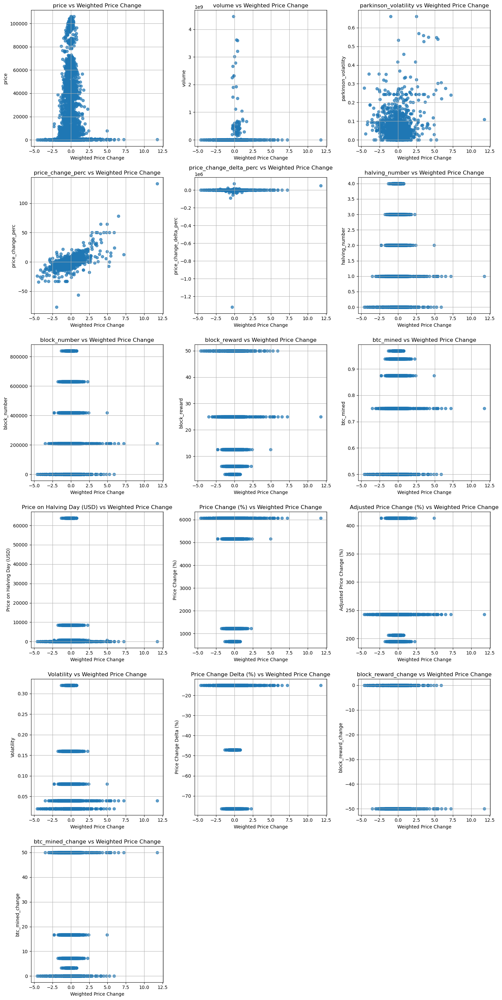

In [399]:
import matplotlib.pyplot as plt

# Select numeric columns for comparison
numeric_columns = bitcoin_df.select_dtypes(include=['float64', 'int64']).columns

# Remove 'weighted_price_change' from the list to avoid self-comparison
columns_to_compare = [col for col in numeric_columns if col != 'weighted_price_change']

# Create subplots
num_cols = len(columns_to_compare)
fig, axes = plt.subplots(nrows=(num_cols + 2) // 3, ncols=3, figsize=(15, 5 * ((num_cols + 2) // 3)))
axes = axes.flatten()

# Plot each column against 'weighted_price_change'
for i, col in enumerate(columns_to_compare):
    ax = axes[i]
    ax.scatter(bitcoin_df['weighted_price_change'], bitcoin_df[col], alpha=0.7)
    ax.set_title(f'{col} vs Weighted Price Change')
    ax.set_xlabel('Weighted Price Change')
    ax.set_ylabel(col)
    ax.grid(True)

# Remove unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

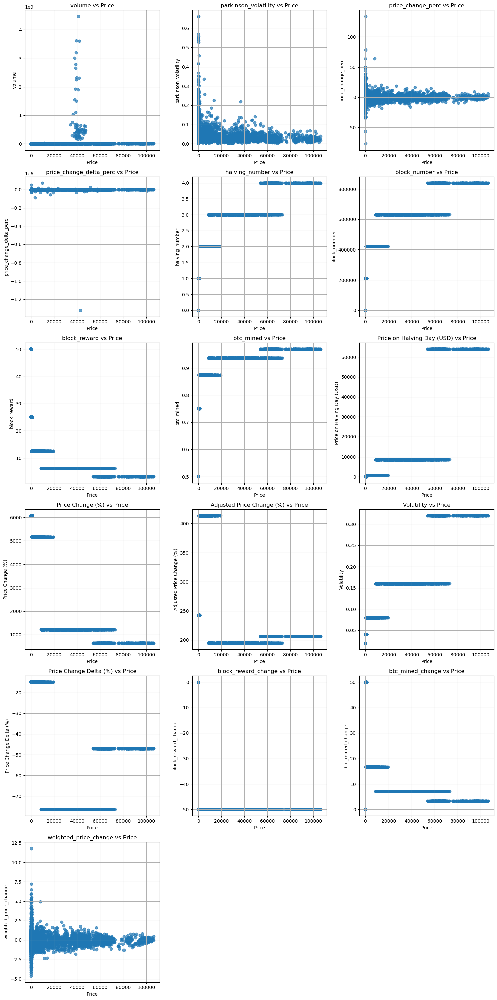

In [400]:
# Select numeric columns for comparison
numeric_columns = bitcoin_df.select_dtypes(include=['float64', 'int64']).columns

# Remove 'price' from the list to avoid self-comparison
columns_to_compare = [col for col in numeric_columns if col != 'price']

# Create subplots
num_cols = len(columns_to_compare)
fig, axes = plt.subplots(nrows=(num_cols + 2) // 3, ncols=3, figsize=(15, 5 * ((num_cols + 2) // 3)))
axes = axes.flatten()

# Plot each column against 'price'
for i, col in enumerate(columns_to_compare):
    ax = axes[i]
    ax.scatter(bitcoin_df['price'], bitcoin_df[col], alpha=0.7)
    ax.set_title(f'{col} vs Price')
    ax.set_xlabel('Price')
    ax.set_ylabel(col)
    ax.grid(True)

# Remove unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

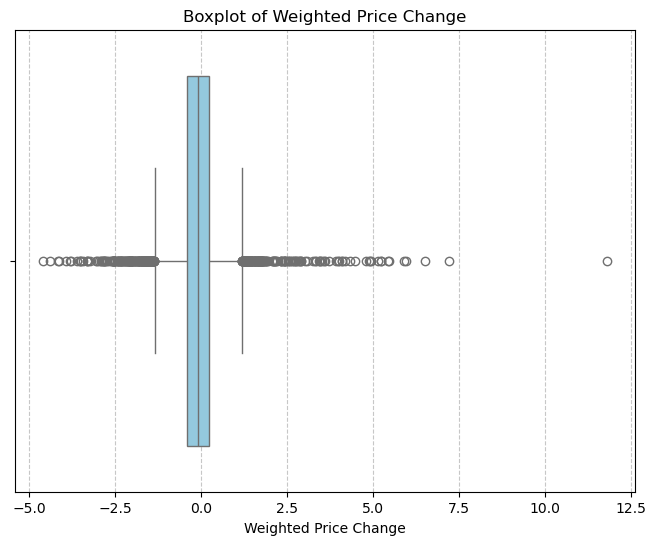

In [401]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a boxplot for the weighted_price_change column
plt.figure(figsize=(8, 6))
sns.boxplot(data=bitcoin_df, x='weighted_price_change', color='skyblue')
plt.title('Boxplot of Weighted Price Change')
plt.xlabel('Weighted Price Change')
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.show()

In [402]:
weighted = bitcoin_df[bitcoin_df['weighted_price_change'] > 3]
weighted

,date,price,volume,parkinson_volatility,price_change_perc,price_change_delta_perc,halving_number,block_number,block_reward,btc_mined,Price on Halving Day (USD),Price Change (%),Adjusted Price Change (%),Volatility,Price Change Delta (%),block_reward_change,btc_mined_change,weighted_price_change
5,2010-11-06,0.4,32759.99,0.550289,33.333333,-33.333333,0.0,0.0,50.0,0.500,0.20,6075.000000,243.000000,0.02,-14.939105,0.0,0.000000,4.166176
6,2010-11-07,0.3,77220.00,0.306782,50.000000,-226.216257,0.0,0.0,50.0,0.500,0.20,6075.000000,243.000000,0.02,-14.939105,0.0,0.000000,5.897794
14,2010-11-15,0.3,8510.00,0.000000,50.000000,-210.473704,0.0,0.0,50.0,0.500,0.20,6075.000000,243.000000,0.02,-14.939105,0.0,0.000000,4.463868
27,2010-11-28,0.3,20800.00,0.000000,50.000000,-165.550239,0.0,0.0,50.0,0.500,0.20,6075.000000,243.000000,0.02,-14.939105,0.0,0.000000,5.233691
32,2010-12-03,0.3,2570.00,0.243507,50.000000,-167.878788,0.0,0.0,50.0,0.500,0.20,6075.000000,243.000000,0.02,-14.939105,0.0,0.000000,4.862451
45,2010-12-16,0.3,14360.00,0.243507,50.000000,-267.184245,0.0,0.0,50.0,0.500,0.20,6075.000000,243.000000,0.02,-14.939105,0.0,0.000000,3.448003
52,2010-12-23,0.3,8650.00,0.243507,50.000000,-243.828537,0.0,0.0,50.0,0.500,0.20,6075.000000,243.000000,0.02,-14.939105,0.0,0.000000,3.597073
221,2011-06-10,24.0,92210.00,0.231374,64.383562,-405.409203,0.0,0.0,50.0,0.500,0.20,6075.000000,243.000000,0.02,-14.939105,0.0,0.000000,4.088198
274,2011-08-02,12.1,57240.00,0.078232,30.107527,-316.774194,0.0,0.0,50.0,0.500,0.20,6075.000000,243.000000,0.02,-14.939105,0.0,0.000000,3.343205
277,2011-08-05,9.8,30770.00,0.088044,48.484848,-394.638695,0.0,0.0,50.0,0.500,0.20,6075.000000,243.000000,0.02,-14.939105,0.0,0.000000,4.014295


In [403]:
bitcoin_df.head()

,date,price,volume,parkinson_volatility,price_change_perc,price_change_delta_perc,halving_number,block_number,block_reward,btc_mined,Price on Halving Day (USD),Price Change (%),Adjusted Price Change (%),Volatility,Price Change Delta (%),block_reward_change,btc_mined_change,weighted_price_change
0,2010-11-01,0.2,21260.0,0.000000,0.000000,-157.738437,0.0,0.0,50.0,0.5,0.2,6075.0,243.0,0.02,-14.939105,0.0,0.0,-0.166858
1,2010-11-02,0.2,5850.0,0.000000,0.000000,-138.861375,0.0,0.0,50.0,0.5,0.2,6075.0,243.0,0.02,-14.939105,0.0,0.0,-0.417716
2,2010-11-03,0.2,61470.0,0.659784,0.000000,-100.000000,0.0,0.0,50.0,0.5,0.2,6075.0,243.0,0.02,-14.939105,0.0,0.0,-1.007761
3,2010-11-04,0.2,29700.0,0.000000,-33.333333,33.333333,0.0,0.0,50.0,0.5,0.2,6075.0,243.0,0.02,-14.939105,0.0,0.0,-3.058539
4,2010-11-05,0.3,36620.0,0.243507,-25.000000,-175.000000,0.0,0.0,50.0,0.5,0.2,6075.0,243.0,0.02,-14.939105,0.0,0.0,-1.230923


In [404]:
# Ensure the 'date' column is in datetime format
bitcoin_df['date'] = pd.to_datetime(bitcoin_df['date'])

# Get the last date in the dataset
last_date = bitcoin_df['date'].max()

# Define the new date range from the day after the last date to 2052-06-30
new_dates = pd.date_range(start=last_date + pd.Timedelta(days=1), end='2052-06-30')

# Create a DataFrame for the new rows
new_rows = pd.DataFrame({'date': new_dates})

# Assign halving numbers based on the date ranges
new_rows['halving_number'] = 0
new_rows.loc[(new_rows['date'] >= '2044-06-30') & (new_rows['date'] < '2048-06-30'), 'halving_number'] = 9
new_rows.loc[(new_rows['date'] >= '2048-06-30') & (new_rows['date'] <= '2052-06-30'), 'halving_number'] = 10

# Merge the new rows with the existing DataFrame
bitcoin_df = pd.concat([bitcoin_df, new_rows], ignore_index=True)

# Sort the DataFrame by date
bitcoin_df = bitcoin_df.sort_values('date').reset_index(drop=True)

# Display the updated DataFrame
bitcoin_df.tail()

,date,price,volume,parkinson_volatility,price_change_perc,price_change_delta_perc,halving_number,block_number,block_reward,btc_mined,Price on Halving Day (USD),Price Change (%),Adjusted Price Change (%),Volatility,Price Change Delta (%),block_reward_change,btc_mined_change,weighted_price_change
15213,2052-06-26,NaN,NaN,NaN,NaN,NaN,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15214,2052-06-27,NaN,NaN,NaN,NaN,NaN,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15215,2052-06-28,NaN,NaN,NaN,NaN,NaN,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15216,2052-06-29,NaN,NaN,NaN,NaN,NaN,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15217,2052-06-30,NaN,NaN,NaN,NaN,NaN,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [406]:
# Define the halving data for reference
halving_data = {
    "halving_number": [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
    "block_number": [0, 210000, 420000, 630000, 840000, 1050000, 1260000, 1470000, 1680000, 1890000, 2100000],
    "block_reward": [50, 25, 12.5, 6.25, 3.125, 1.5625, 0.78125, 0.390625, 0.1953125, 0.09765625, 0.048828125],
    "btc_mined": [50, 75, 87.5, 93.75, 96.875, 98.4375, 99.21875, 99.609375, 99.8046875, 99.90234375, 99.951171875]
}

# Convert the halving data into a DataFrame
halving_df = pd.DataFrame(halving_data)

# Ensure 'halving_number' is numeric in both DataFrames for a proper merge
bitcoin_df['halving_number'] = pd.to_numeric(bitcoin_df['halving_number'], errors='coerce')
halving_df['halving_number'] = pd.to_numeric(halving_df['halving_number'], errors='coerce')

# Merge the halving data into the main DataFrame
bitcoin_df = pd.merge(bitcoin_df, halving_df, on="halving_number", how="left")

# Check if 'block_reward' and 'btc_mined' columns exist after the merge
if 'block_reward' in bitcoin_df.columns and 'btc_mined' in bitcoin_df.columns:
    # Calculate block_reward_change and btc_mined_change
    bitcoin_df['block_reward_change'] = bitcoin_df['block_reward'].pct_change() * 100
    bitcoin_df['btc_mined_change'] = bitcoin_df['btc_mined'].pct_change() * 100
else:
    raise KeyError("The columns 'block_reward' or 'btc_mined' are missing after the merge.")

# Fill NaN values in the new rows (if any)
bitcoin_df[['block_reward_change', 'btc_mined_change']] = bitcoin_df[['block_reward_change', 'btc_mined_change']].fillna(0)

# Display the updated DataFrame
bitcoin_df.tail()

,date,price,volume,parkinson_volatility,price_change_perc,price_change_delta_perc,halving_number,block_number_x,block_reward_x,btc_mined_x,...,Price Change Delta (%),block_reward_change,btc_mined_change,weighted_price_change,block_number_y,block_reward_y,btc_mined_y,block_number,block_reward,btc_mined
15213,2052-06-26,NaN,NaN,NaN,NaN,NaN,10.0,NaN,NaN,NaN,...,NaN,0.0,0.0,NaN,2100000,0.048828,99.951172,2100000,0.048828,99.951172
15214,2052-06-27,NaN,NaN,NaN,NaN,NaN,10.0,NaN,NaN,NaN,...,NaN,0.0,0.0,NaN,2100000,0.048828,99.951172,2100000,0.048828,99.951172
15215,2052-06-28,NaN,NaN,NaN,NaN,NaN,10.0,NaN,NaN,NaN,...,NaN,0.0,0.0,NaN,2100000,0.048828,99.951172,2100000,0.048828,99.951172
15216,2052-06-29,NaN,NaN,NaN,NaN,NaN,10.0,NaN,NaN,NaN,...,NaN,0.0,0.0,NaN,2100000,0.048828,99.951172,2100000,0.048828,99.951172
15217,2052-06-30,NaN,NaN,NaN,NaN,NaN,10.0,NaN,NaN,NaN,...,NaN,0.0,0.0,NaN,2100000,0.048828,99.951172,2100000,0.048828,99.951172


In [407]:
# Drop all columns with the '_x' suffix
bitcoin_df = bitcoin_df[[col for col in bitcoin_df.columns if not col.endswith('_x')]]

# Rename columns with the '_y' suffix by removing the suffix
bitcoin_df.rename(columns=lambda col: col[:-2] if col.endswith('_y') else col, inplace=True)

# Display the updated DataFrame
bitcoin_df.head()

,date,price,volume,parkinson_volatility,price_change_perc,price_change_delta_perc,halving_number,Price on Halving Day (USD),Price Change (%),Adjusted Price Change (%),...,Price Change Delta (%),block_reward_change,btc_mined_change,weighted_price_change,block_number,block_reward,btc_mined,block_number,block_reward,btc_mined
0,2010-11-01,0.2,21260.0,0.000000,0.000000,-157.738437,0.0,0.2,6075.0,243.0,...,-14.939105,0.0,0.0,-0.166858,0,50.0,50.0,0,50.0,50.0
1,2010-11-02,0.2,5850.0,0.000000,0.000000,-138.861375,0.0,0.2,6075.0,243.0,...,-14.939105,0.0,0.0,-0.417716,0,50.0,50.0,0,50.0,50.0
2,2010-11-03,0.2,61470.0,0.659784,0.000000,-100.000000,0.0,0.2,6075.0,243.0,...,-14.939105,0.0,0.0,-1.007761,0,50.0,50.0,0,50.0,50.0
3,2010-11-04,0.2,29700.0,0.000000,-33.333333,33.333333,0.0,0.2,6075.0,243.0,...,-14.939105,0.0,0.0,-3.058539,0,50.0,50.0,0,50.0,50.0
4,2010-11-05,0.3,36620.0,0.243507,-25.000000,-175.000000,0.0,0.2,6075.0,243.0,...,-14.939105,0.0,0.0,-1.230923,0,50.0,50.0,0,50.0,50.0


In [ ]:
# # Define the target percentage changes for each halving
# assumed_values = {
#     5.0: -350,
#     6.0: -190,
#     7.0: -120,
#     8.0: -70,
#     9.0: -40,
#     10.0: -25
# }

# # Ensure the 'date' column is in datetime format
# bitcoin_df['date'] = pd.to_datetime(bitcoin_df['date'])

# # Sort the DataFrame by date
# bitcoin_df = bitcoin_df.sort_values('date')

# # Iterate through each halving interval
# for halving in range(5, 10):  # From halving 5 to 8
#     # Check if the current and next halving exist in the DataFrame
#     if (bitcoin_df['halving_number'] == halving).any() and (bitcoin_df['halving_number'] == halving + 1).any():
#         # Get the start and end dates for the current halving interval
#         start_date = bitcoin_df.loc[bitcoin_df['halving_number'] == halving, 'date'].iloc[0]
#         end_date = bitcoin_df.loc[bitcoin_df['halving_number'] == halving + 1, 'date'].iloc[0]
        
#         # Get the current and target percentage change
#         current_value = assumed_values[halving]
#         target_value = assumed_values[halving + 1]
        
#         # Calculate the number of days in the interval
#         num_days = (end_date - start_date).days
        
#         # Calculate the daily change
#         daily_change = (target_value - current_value) / num_days
        
#         # Update the percentage change day by day
#         mask = (bitcoin_df['date'] >= start_date) & (bitcoin_df['date'] < end_date)
#         bitcoin_df.loc[mask, 'price_change_perc'] = [
#             current_value + (i * daily_change) for i in range(num_days)
#         ]
#     else:
#         print(f"Skipping halving interval {halving} to {halving + 1} as it does not exist in the DataFrame.")

# # Display the updated DataFrame
# bitcoin_df[['date', 'halving_number', 'price_change_perc']].dropna()

In [408]:
bitcoin_df = bitcoin_df[bitcoin_df['halving_number'] < 10]
bitcoin_df

,date,price,volume,parkinson_volatility,price_change_perc,price_change_delta_perc,halving_number,Price on Halving Day (USD),Price Change (%),Adjusted Price Change (%),...,Price Change Delta (%),block_reward_change,btc_mined_change,weighted_price_change,block_number,block_reward,btc_mined,block_number,block_reward,btc_mined
0,2010-11-01,0.2,21260.0,0.000000,0.000000,-157.738437,0.0,0.2,6075.0,243.0,...,-14.939105,0.0,0.0,-0.166858,0,50.000000,50.000000,0,50.000000,50.000000
1,2010-11-02,0.2,5850.0,0.000000,0.000000,-138.861375,0.0,0.2,6075.0,243.0,...,-14.939105,0.0,0.0,-0.417716,0,50.000000,50.000000,0,50.000000,50.000000
2,2010-11-03,0.2,61470.0,0.659784,0.000000,-100.000000,0.0,0.2,6075.0,243.0,...,-14.939105,0.0,0.0,-1.007761,0,50.000000,50.000000,0,50.000000,50.000000
3,2010-11-04,0.2,29700.0,0.000000,-33.333333,33.333333,0.0,0.2,6075.0,243.0,...,-14.939105,0.0,0.0,-3.058539,0,50.000000,50.000000,0,50.000000,50.000000
4,2010-11-05,0.3,36620.0,0.243507,-25.000000,-175.000000,0.0,0.2,6075.0,243.0,...,-14.939105,0.0,0.0,-1.230923,0,50.000000,50.000000,0,50.000000,50.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13751,2048-06-25,NaN,NaN,NaN,NaN,NaN,9.0,NaN,NaN,NaN,...,NaN,0.0,0.0,NaN,1890000,0.097656,99.902344,1890000,0.097656,99.902344
13752,2048-06-26,NaN,NaN,NaN,NaN,NaN,9.0,NaN,NaN,NaN,...,NaN,0.0,0.0,NaN,1890000,0.097656,99.902344,1890000,0.097656,99.902344
13753,2048-06-27,NaN,NaN,NaN,NaN,NaN,9.0,NaN,NaN,NaN,...,NaN,0.0,0.0,NaN,1890000,0.097656,99.902344,1890000,0.097656,99.902344
13754,2048-06-28,NaN,NaN,NaN,NaN,NaN,9.0,NaN,NaN,NaN,...,NaN,0.0,0.0,NaN,1890000,0.097656,99.902344,1890000,0.097656,99.902344


In [409]:
# Ensure the 'date' column is in datetime format
bitcoin_df['date'] = pd.to_datetime(bitcoin_df['date'], errors='coerce')

# Create a new column for weights based on proximity to the halving date
bitcoin_df['date_weight'] = 0.0

# Iterate through each row in bitcoin_df
for idx, row in bitcoin_df.iterrows():
    halving_date = row['date']
    
    # Define the one-year window before and after the halving
    start_date = halving_date - pd.Timedelta(days=365)
    end_date = halving_date + pd.Timedelta(days=365)
    
    # Filter rows within the one-year window
    window_data = bitcoin_df[(bitcoin_df['date'] >= start_date) & (bitcoin_df['date'] <= end_date)]
    
    # Calculate weights (inverse distance from the halving date)
    window_data['weight'] = 1 / (1 + abs((window_data['date'] - halving_date).dt.days))
    
    # Assign the weight to the current row
    bitcoin_df.at[idx, 'date_weight'] = window_data['weight'].sum()

# Display the updated DataFrame
bitcoin_df[['date', 'date_weight']].head()

/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/180448474.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  window_data['weight'] = 1 / (1 + abs((window_data['date'] - halving_date).dt.days))
/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/180448474.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  window_data['weight'] = 1 / (1 + abs((window_data['date'] - halving_date).dt.days))
/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/180448474.py:19: Settin

,date,date_weight
0,2010-11-01,6.481214
1,2010-11-02,6.981214
2,2010-11-03,7.314548
3,2010-11-04,7.564548
4,2010-11-05,7.764548


In [410]:
# Ensure the 'date' column is in datetime format
bitcoin_df['date'] = pd.to_datetime(bitcoin_df['date'], errors='coerce')

# Create new columns for weighted parkinson_volatility and price_change_perc
bitcoin_df['weighted_parkinson_volatility'] = 0.0
bitcoin_df['weighted_price_change_perc'] = 0.0

# Iterate through each row in bitcoin_df
for idx, row in bitcoin_df.iterrows():
    halving_date = row['date']
    
    # Define the one-year window before and after the halving
    start_date = halving_date - pd.Timedelta(days=365)
    end_date = halving_date + pd.Timedelta(days=365)
    
    # Filter rows within the one-year window
    window_data = bitcoin_df[(bitcoin_df['date'] >= start_date) & (bitcoin_df['date'] <= end_date)]
    
    # Calculate weights (inverse distance from the halving date)
    window_data['weight'] = 1 / (1 + abs((window_data['date'] - halving_date).dt.days))
    
    # Calculate weighted parkinson_volatility and price_change_perc
    weighted_parkinson = (window_data['parkinson_volatility'] * window_data['weight']).sum() / window_data['weight'].sum()
    weighted_price_change = (window_data['price_change_perc'] * window_data['weight']).sum() / window_data['weight'].sum()
    
    # Assign the weighted values to the current row
    bitcoin_df.at[idx, 'weighted_parkinson_volatility'] = weighted_parkinson
    bitcoin_df.at[idx, 'weighted_price_change_perc'] = weighted_price_change

# Display the updated DataFrame
bitcoin_df[['date', 'weighted_parkinson_volatility', 'weighted_price_change_perc']].head()

/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/2031356172.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  window_data['weight'] = 1 / (1 + abs((window_data['date'] - halving_date).dt.days))
/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/2031356172.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  window_data['weight'] = 1 / (1 + abs((window_data['date'] - halving_date).dt.days))
/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/2031356172.py:20: Set

,date,weighted_parkinson_volatility,weighted_price_change_perc
0,2010-11-01,0.120945,-0.166858
1,2010-11-02,0.136709,-0.417716
2,2010-11-03,0.187360,-1.007761
3,2010-11-04,0.155805,-3.058539
4,2010-11-05,0.174785,-1.230923


In [411]:
# Ensure the 'date' column is in datetime format
bitcoin_df['date'] = pd.to_datetime(bitcoin_df['date'], errors='coerce')

# Create new columns for weighted parkinson_volatility and price_change_perc
bitcoin_df['weighted_volume'] = 0.0

# Iterate through each row in bitcoin_df
for idx, row in bitcoin_df.iterrows():
    halving_date = row['date']
    
    # Define the one-year window before and after the halving
    start_date = halving_date - pd.Timedelta(days=365)
    end_date = halving_date + pd.Timedelta(days=365)
    
    # Filter rows within the one-year window
    window_data = bitcoin_df[(bitcoin_df['date'] >= start_date) & (bitcoin_df['date'] <= end_date)]
    
    # Calculate weights (inverse distance from the halving date)
    window_data['weight'] = 1 / (1 + abs((window_data['date'] - halving_date).dt.days))
    
    # Calculate weighted parkinson_volatility and price_change_perc
    weighted_volume = (window_data['volume'] * window_data['weight']).sum() / window_data['weight'].sum()
    # Assign the weighted values to the current row
    bitcoin_df.at[idx, 'weighted_volume'] = weighted_volume


/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/2952673138.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  window_data['weight'] = 1 / (1 + abs((window_data['date'] - halving_date).dt.days))
/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/2952673138.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  window_data['weight'] = 1 / (1 + abs((window_data['date'] - halving_date).dt.days))
/var/folders/2m/_3np4g752dzdn21lzc5c7nsm0000gn/T/ipykernel_47187/2952673138.py:19: Set

In [412]:
from sklearn.linear_model import LinearRegression
import numpy as np

# Prepare the data
historical_data = bitcoin_df[['date_weight', 'weighted_price_change_perc', 'weighted_parkinson_volatility']].dropna()

# Define features (X) and targets (y)
X = historical_data[['date_weight']]
y_price_change = historical_data['weighted_price_change_perc']
y_volatility = historical_data['weighted_parkinson_volatility']
# y_volume = historical_data['weighted_volume']

# Train models
price_model = LinearRegression().fit(X, y_price_change)
volatility_model = LinearRegression().fit(X, y_volatility)
# volume_model = LinearRegression().fit(X, y_volume)

# Print model coefficients (optional)
print(f"Price Change Model Coefficients: {price_model.coef_}, Intercept: {price_model.intercept_}")
print(f"Volatility Model Coefficients: {volatility_model.coef_}, Intercept: {volatility_model.intercept_}")
# print(f"Volume Model Coefficients: {volume_model.coef_}, Intercept: {volume_model.intercept_}")

Price Change Model Coefficients: [-0.01260429], Intercept: 0.12083693569661551
Volatility Model Coefficients: [-0.01642239], Intercept: 0.20976704581678873


In [413]:
# Use the trained models to predict future values
bitcoin_df['predicted_price_change_perc'] = price_model.predict(bitcoin_df[['date_weight']])
bitcoin_df['predicted_parkinson_volatility'] = volatility_model.predict(bitcoin_df[['date_weight']])
# bitcoin_df['predicted_volume'] = volume_model.predict(bitcoin_df[['date_weight']])

# Ensure no negative values (if applicable)
bitcoin_df['predicted_price_change_perc'] = bitcoin_df['predicted_price_change_perc'].clip(lower=0)
bitcoin_df['predicted_parkinson_volatility'] = bitcoin_df['predicted_parkinson_volatility'].clip(lower=0)
# bitcoin_df['predicted_volume'] = bitcoin_df['predicted_volume'].clip(lower=0)
# Display the predictions
bitcoin_df[['date', 'predicted_price_change_perc', 'predicted_parkinson_volatility']]

,date,predicted_price_change_perc,predicted_parkinson_volatility
0,2010-11-01,0.039146,0.103330
1,2010-11-02,0.032844,0.095119
2,2010-11-03,0.028642,0.089645
3,2010-11-04,0.025491,0.085539
4,2010-11-05,0.022970,0.082255
...,...,...,...
13751,2048-06-25,0.022970,0.082255
13752,2048-06-26,0.025491,0.085539
13753,2048-06-27,0.028642,0.089645
13754,2048-06-28,0.032844,0.095119


In [ ]:
bitcoin_df.columns.to_list()vjlgvljg

SyntaxError: invalid syntax (649063756.py, line 1)

In [ ]:
from sklearn.linear_model import LinearRegression
import numpy as np

# Prepare the data
historical_data_x = bitcoin_df[['price', 'weighted_volume']]

# Define features (X) and targets (y)
X = historical_data_x[['price']]
y_volume = historical_data_x['weighted_volume']

# Train models
volume_model = LinearRegression().fit(X, y_volume)

# Print model coefficients (optional)
print(f"Volume Model Coefficients: {volume_model.coef_}, Intercept: {volume_model.intercept_}")

In [ ]:
bitcoin_df['predicted_volume'] = volume_model.predict(bitcoin_df[['date_weight']])

In [ ]:
bitcoin_df_model = bitcoin_df.drop(columns=[
    #'date',
    #'price',
    #'volume',
    'parkinson_volatility',
    'price_change_perc',
    'price_change_delta_perc',
    'halving_number',
    'Price on Halving Day (USD)',
    'Price Change (%)',
    'Adjusted Price Change (%)',
    'Volatility',
    'Price Change Delta (%)',
    'block_reward_change',
    'btc_mined_change',
    'weighted_price_change',
    'block_number',
    'block_reward',
    'btc_mined',
    'block_number',
    'block_reward',
    'btc_mined',
    #'date_weight',
    'weighted_parkinson_volatility',
    'weighted_price_change_perc',
    #'weighted_volume',
    #'predicted_price_change_perc',
    #'predicted_parkinson_volatility',
    #'predicted_volume',
    'predicted_parkinson_volume'
    ])
bitcoin_df_model